In [1]:
import sys
sys.path.append('..')
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from torchvision.ops import nms
from utilis.metrics import YOLOMetrics
from models.darknet19detector import Darknet19Detector
from utilis.dataset import YOLODataset
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import os
from PIL import Image

### Model testing


In [20]:
BATCH_SIZE = 8
ANCHORS = [
    [0.56543644, 0.43573397],
    [0.32582974, 0.32626539],
    [0.15752303, 0.15084553],
    [0.72250432,0.62789971],
]
TRANSFORM = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Reload the model
model = Darknet19Detector(num_classes=4, num_of_anchors=4)
model.load_state_dict(torch.load('best_model_fixedloss_fixedlabelproblem_70.pth'))  # Load the weights of the best model
model.to(device)
model.eval()  # Set model to evaluation mode

# Load the test dataset
test_dataset = YOLODataset(
    image_dir='../data/resized_test/images',
    label_dir='../data/resized_test/labels',
    anchors=ANCHORS,
    transform=TRANSFORM
)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Evaluate the model
def evaluate_model(model, data_loader, metrics):
    model.eval()
    metrics.reset()

    with torch.no_grad():
        for images, targets in data_loader:
            images = images.to(device)
            outputs = model(images)
            metrics.update_metrics(outputs.cpu(), targets.cpu())
    
    return metrics.compute_metrics()

# Compute Test Metrics
test_metrics = YOLOMetrics(num_classes=4, anchors=ANCHORS)
results= evaluate_model(model, test_loader, test_metrics)

print("\nFinal Test Results:")
print(f"mAP@0.5: {results['map_50']:.4f}")
print(f"mAP@0.75: {results['map_75']:.4f}")
print(f"mAP@0.5:0.95: {results['map']:.4f}")
print(f"Class accuracy: {results['class_accuracy']}")


Final Test Results:
mAP@0.5: 0.2947
mAP@0.75: 0.1709
mAP@0.5:0.95: 0.1762
Class accuracy: tensor([0.1985, 0.1280, 0.2405, 0.1378])


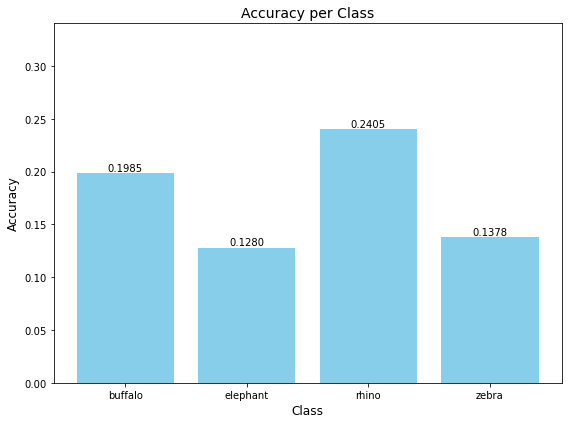

In [21]:
# Define class names
class_names = ['buffalo', 'elephant', 'rhino', 'zebra']
class_accuracy = results['class_accuracy'].tolist()

plt.figure(figsize=(8, 6))
plt.bar(class_names, class_accuracy, color='skyblue')  
plt.xlabel("Class", fontsize=12)
plt.ylabel("Accuracy", fontsize=12)
plt.title("Accuracy per Class", fontsize=14)

for i, accuracy in enumerate(class_accuracy):
    plt.text(i, accuracy, f'{accuracy:.4f}', ha='center', va='bottom')
plt.ylim(0, max(class_accuracy) + 0.1)  
plt.tight_layout() 
plt.show()

### Visualizing the results of the trained model

c:\Users\Vicky\Desktop\M2-MIA\Période2\Optimization for Computer Vision\Project\notebooks\..\utilis\dataset.py:106: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  tw = torch.log(torch.tensor(w / self.anchors[best_anchor][0]))
c:\Users\Vicky\Desktop\M2-MIA\Période2\Optimization for Computer Vision\Project\notebooks\..\utilis\dataset.py:107: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  th = torch.log(torch.tensor(h / self.anchors[best_anchor][1]))


Visualizing prediction for image 1/152...


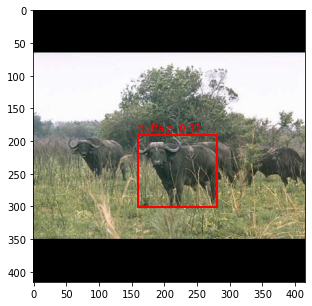

Visualizing prediction for image 2/152...


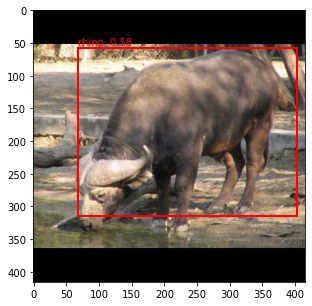

Visualizing prediction for image 3/152...


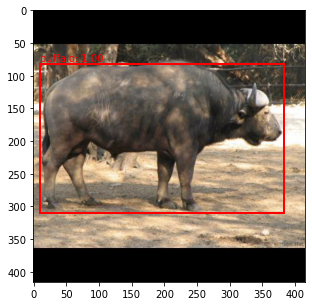

Visualizing prediction for image 4/152...


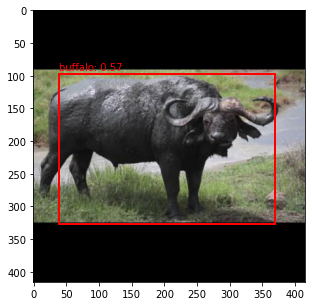

Visualizing prediction for image 5/152...


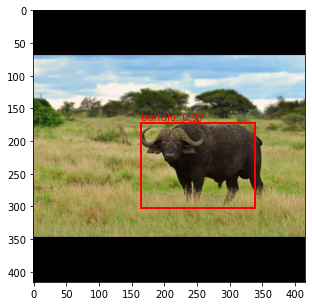

Visualizing prediction for image 6/152...


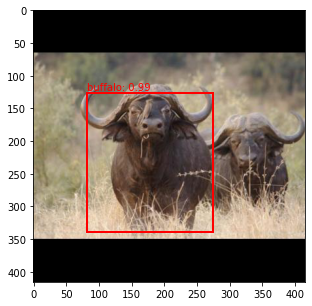

Visualizing prediction for image 7/152...


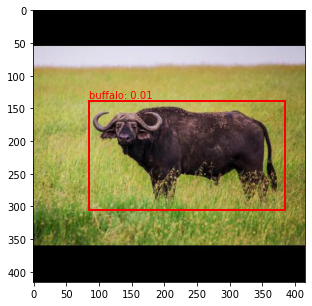

Visualizing prediction for image 8/152...


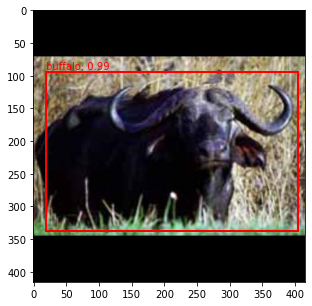

Visualizing prediction for image 9/152...


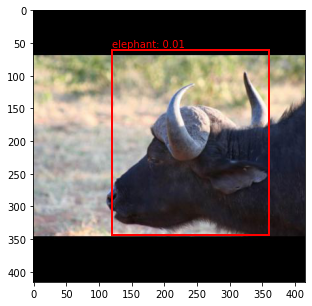

Visualizing prediction for image 10/152...


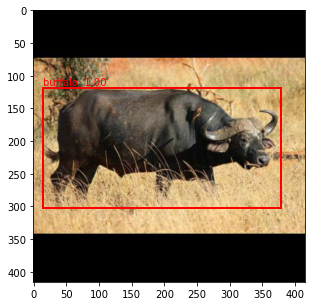

Visualizing prediction for image 11/152...


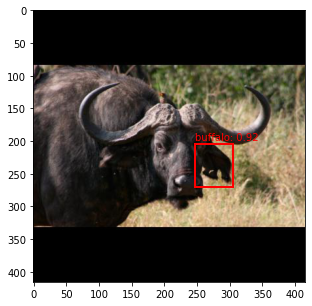

Visualizing prediction for image 12/152...


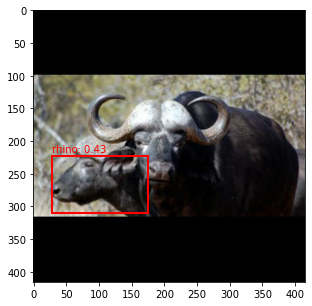

Visualizing prediction for image 13/152...


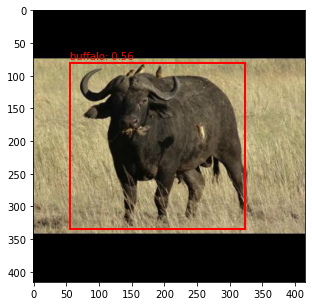

Visualizing prediction for image 14/152...


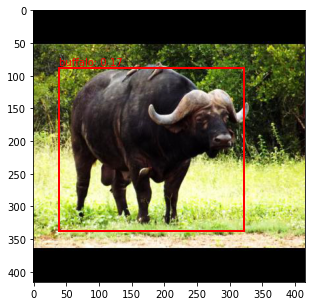

Visualizing prediction for image 15/152...


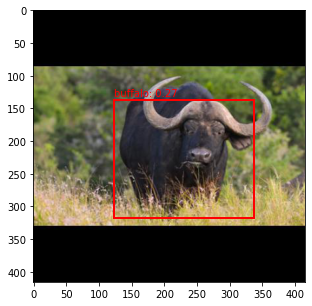

Visualizing prediction for image 16/152...


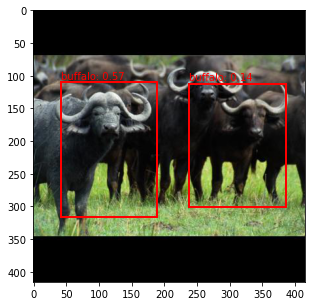

Visualizing prediction for image 17/152...


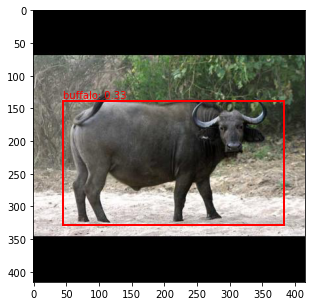

Visualizing prediction for image 18/152...


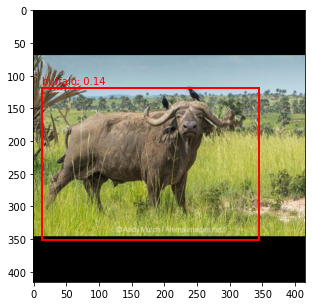

Visualizing prediction for image 19/152...


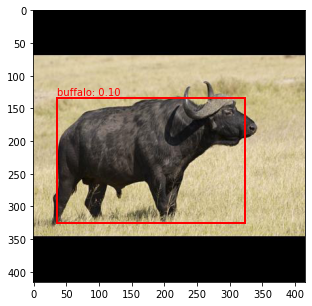

Visualizing prediction for image 20/152...


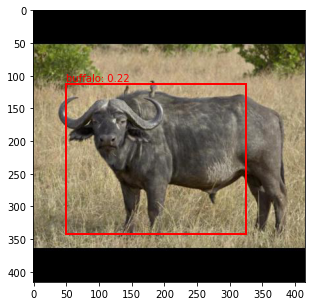

Visualizing prediction for image 21/152...


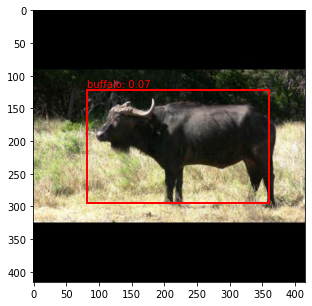

Visualizing prediction for image 22/152...


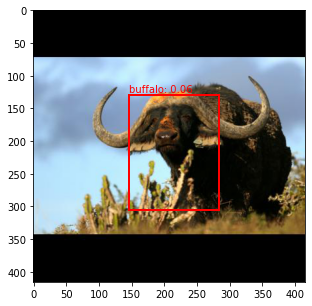

Visualizing prediction for image 23/152...


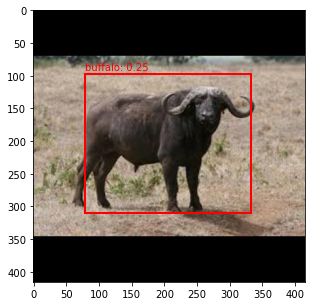

Visualizing prediction for image 24/152...


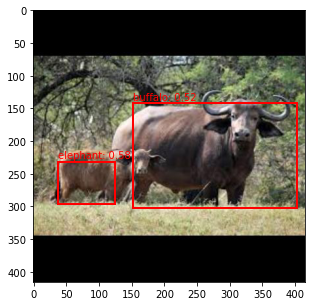

Visualizing prediction for image 25/152...


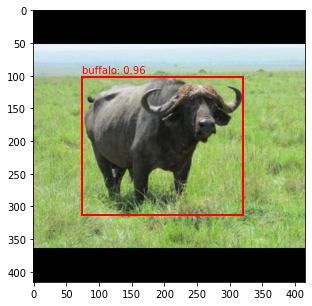

Visualizing prediction for image 26/152...


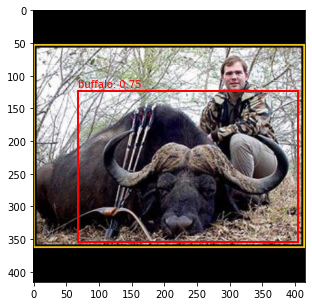

Visualizing prediction for image 27/152...


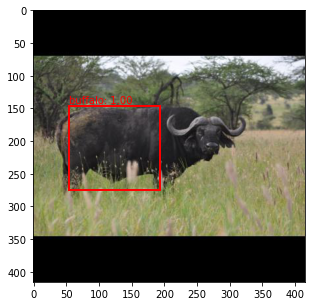

Visualizing prediction for image 28/152...


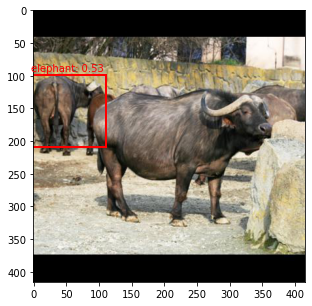

Visualizing prediction for image 29/152...


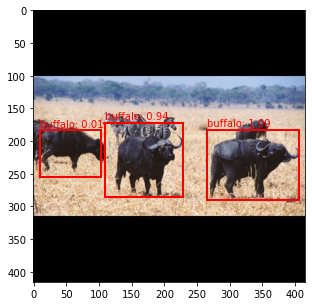

Visualizing prediction for image 30/152...


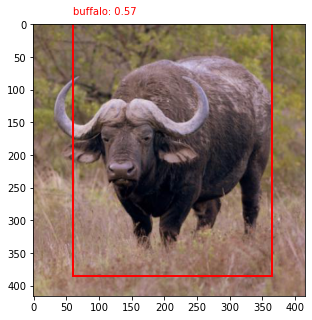

Visualizing prediction for image 31/152...


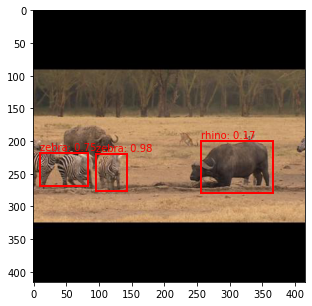

Visualizing prediction for image 32/152...


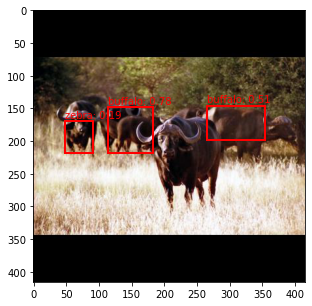

Visualizing prediction for image 33/152...


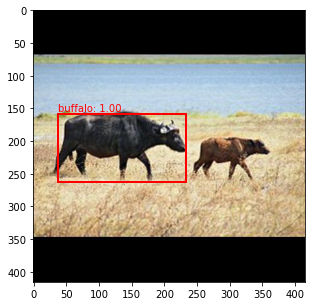

Visualizing prediction for image 34/152...


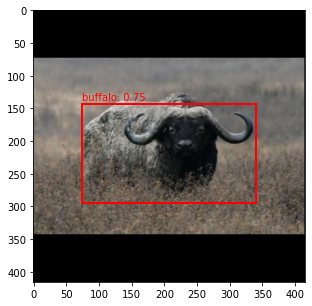

Visualizing prediction for image 35/152...


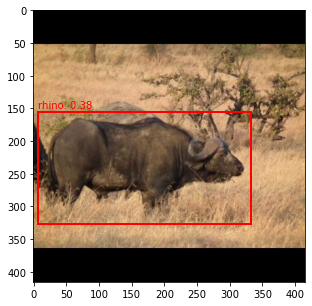

Visualizing prediction for image 36/152...


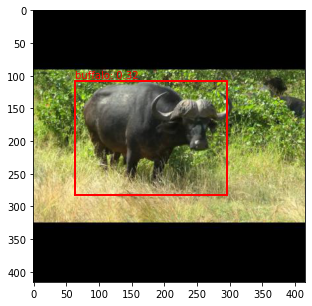

Visualizing prediction for image 37/152...


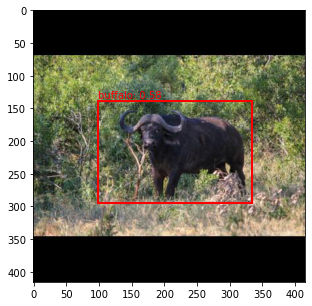

Visualizing prediction for image 38/152...


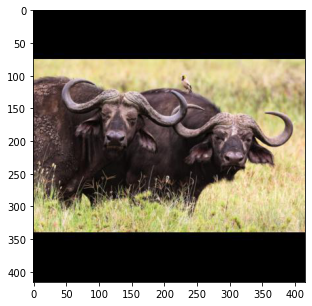

Visualizing prediction for image 39/152...


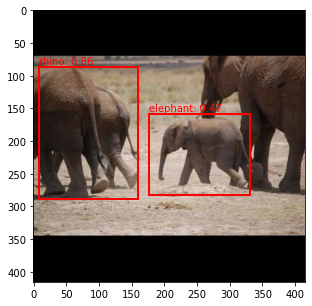

Visualizing prediction for image 40/152...


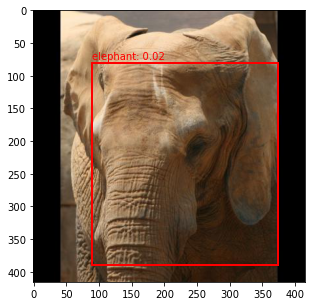

Visualizing prediction for image 41/152...


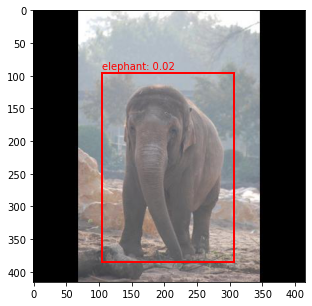

Visualizing prediction for image 42/152...


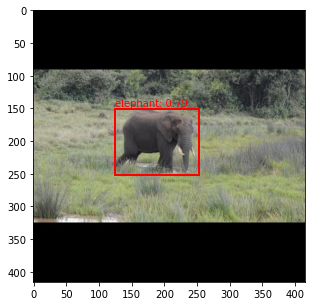

Visualizing prediction for image 43/152...


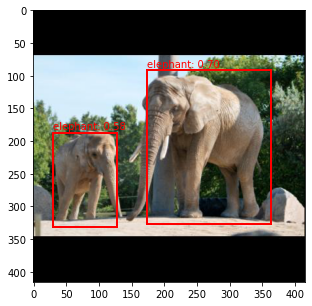

Visualizing prediction for image 44/152...


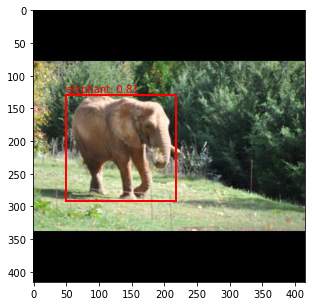

Visualizing prediction for image 45/152...


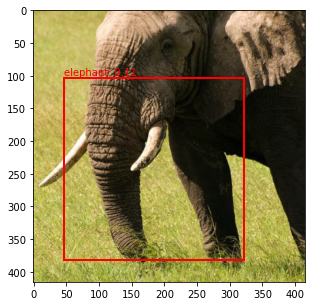

Visualizing prediction for image 46/152...


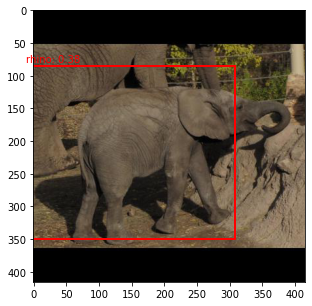

Visualizing prediction for image 47/152...


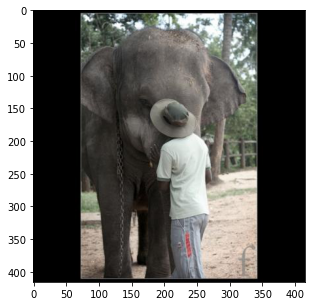

Visualizing prediction for image 48/152...


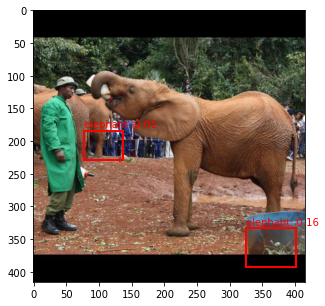

Visualizing prediction for image 49/152...


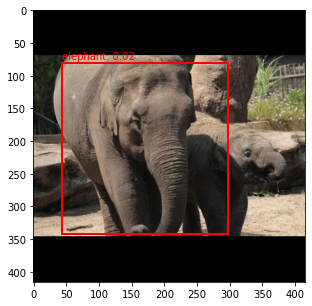

Visualizing prediction for image 50/152...


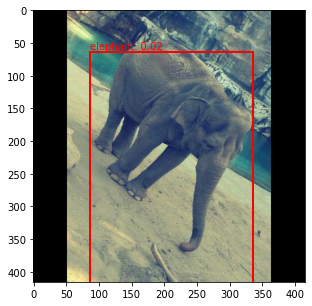

Visualizing prediction for image 51/152...


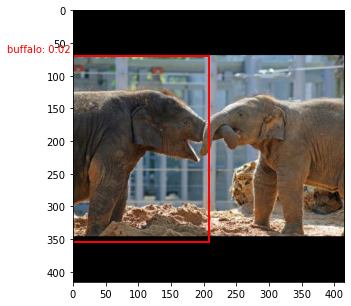

Visualizing prediction for image 52/152...


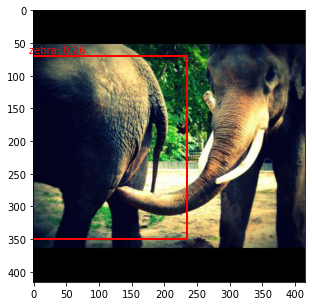

Visualizing prediction for image 53/152...


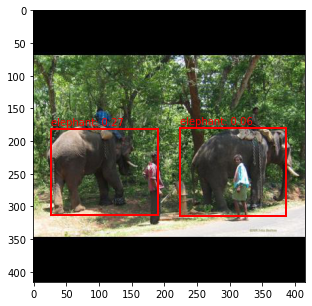

Visualizing prediction for image 54/152...


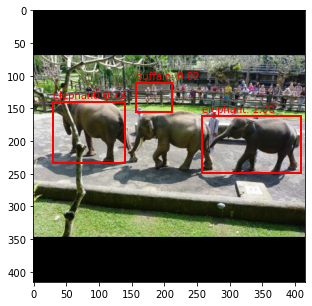

Visualizing prediction for image 55/152...


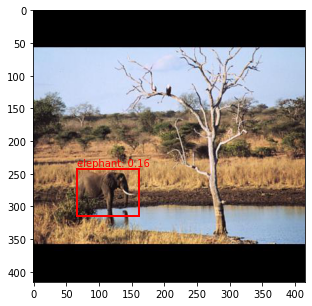

Visualizing prediction for image 56/152...


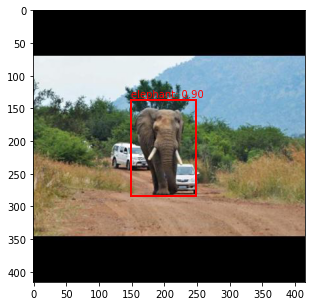

Visualizing prediction for image 57/152...


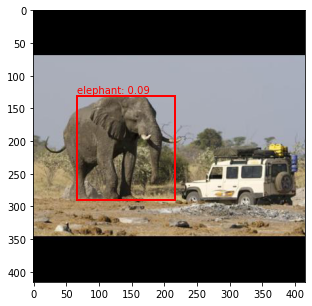

Visualizing prediction for image 58/152...


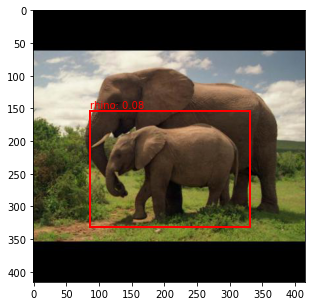

Visualizing prediction for image 59/152...


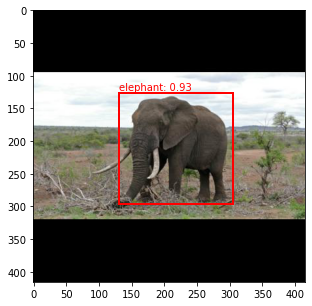

Visualizing prediction for image 60/152...


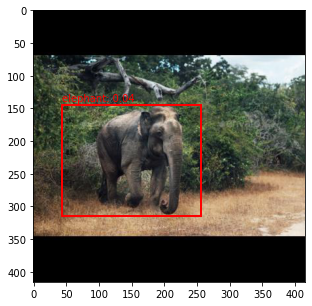

Visualizing prediction for image 61/152...


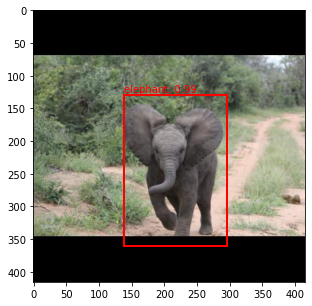

Visualizing prediction for image 62/152...


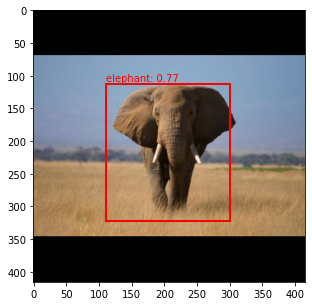

Visualizing prediction for image 63/152...


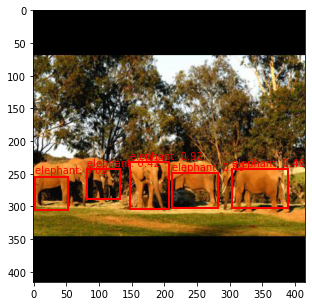

Visualizing prediction for image 64/152...


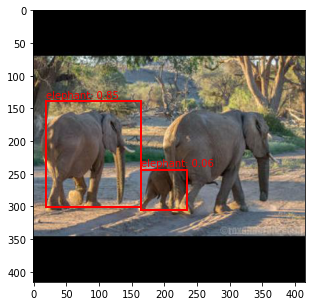

Visualizing prediction for image 65/152...


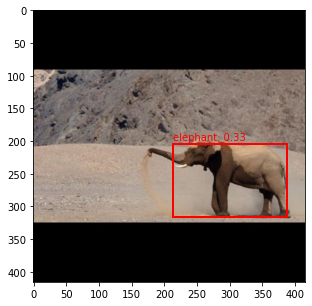

Visualizing prediction for image 66/152...


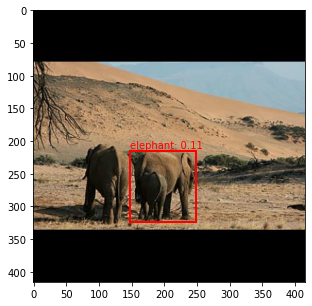

Visualizing prediction for image 67/152...


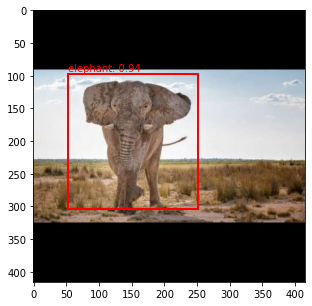

Visualizing prediction for image 68/152...


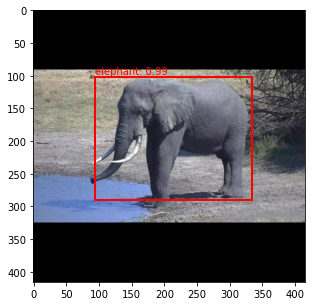

Visualizing prediction for image 69/152...


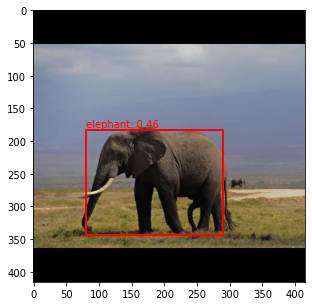

Visualizing prediction for image 70/152...


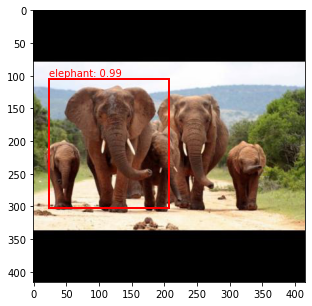

Visualizing prediction for image 71/152...


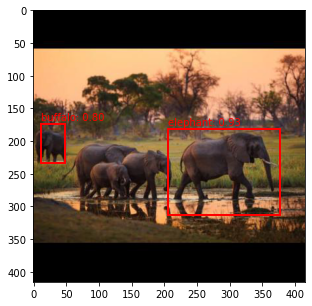

Visualizing prediction for image 72/152...


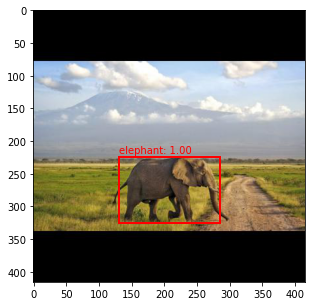

Visualizing prediction for image 73/152...


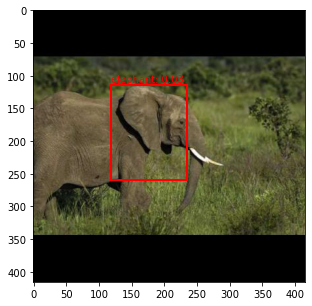

Visualizing prediction for image 74/152...


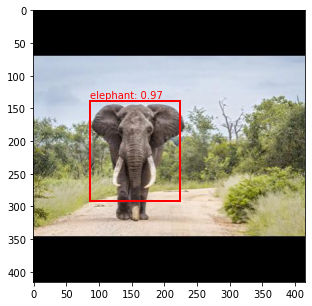

Visualizing prediction for image 75/152...


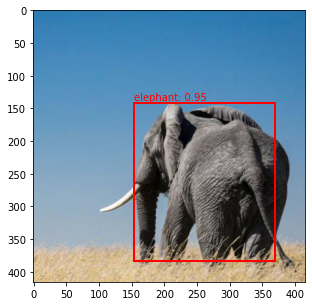

Visualizing prediction for image 76/152...


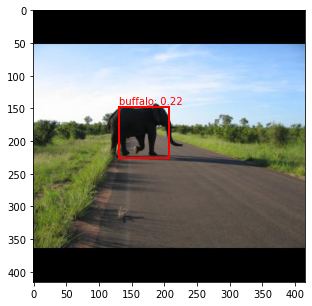

Visualizing prediction for image 77/152...


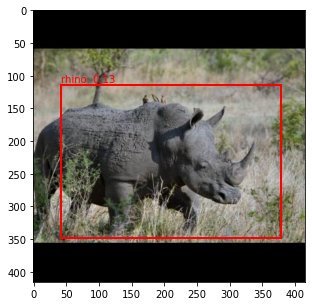

Visualizing prediction for image 78/152...


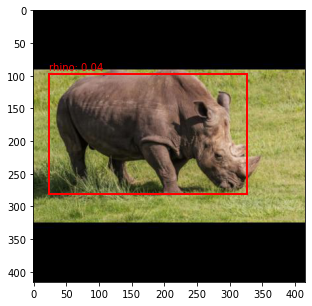

Visualizing prediction for image 79/152...


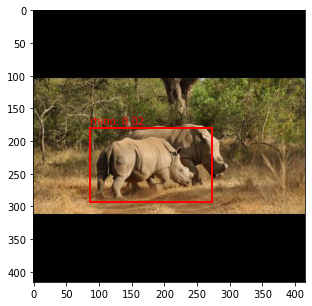

Visualizing prediction for image 80/152...


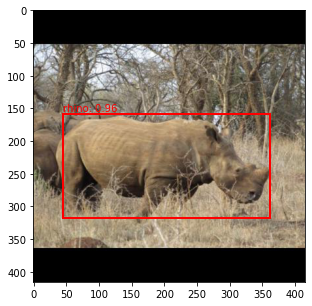

Visualizing prediction for image 81/152...


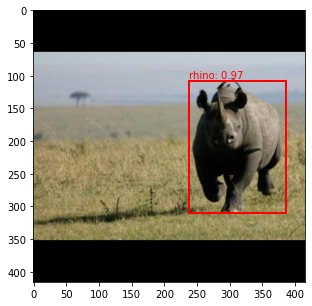

Visualizing prediction for image 82/152...


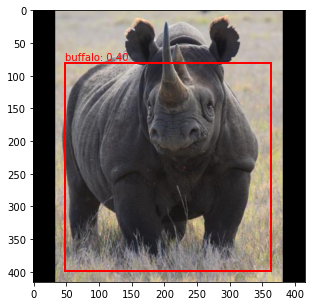

Visualizing prediction for image 83/152...


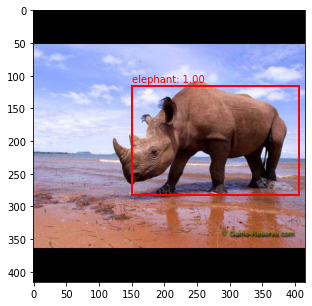

Visualizing prediction for image 84/152...


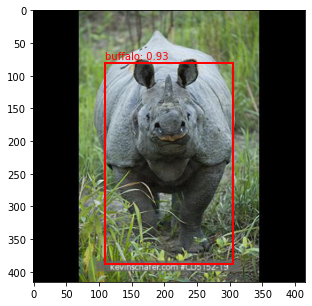

Visualizing prediction for image 85/152...


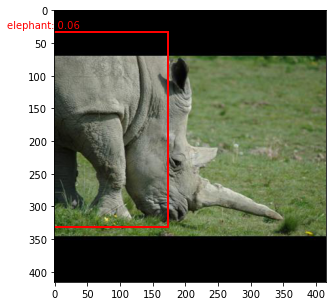

Visualizing prediction for image 86/152...


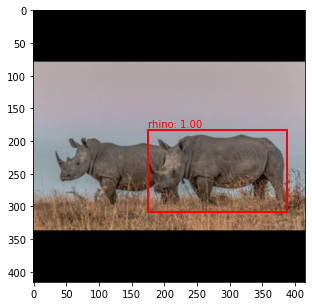

Visualizing prediction for image 87/152...


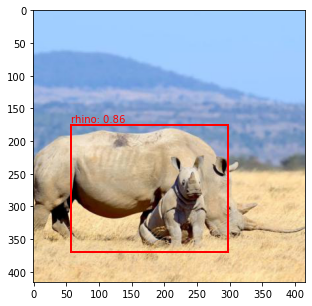

Visualizing prediction for image 88/152...


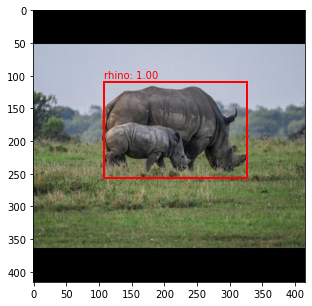

Visualizing prediction for image 89/152...


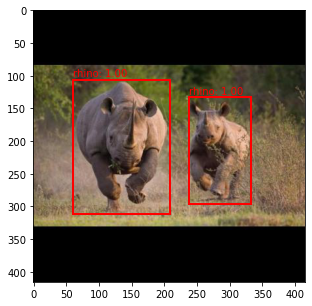

Visualizing prediction for image 90/152...


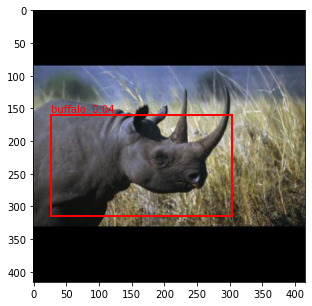

Visualizing prediction for image 91/152...


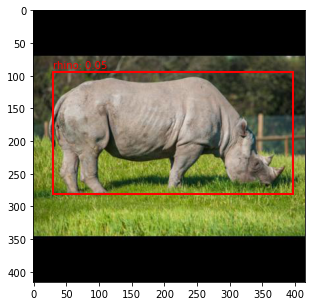

Visualizing prediction for image 92/152...


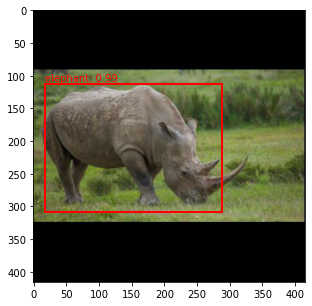

Visualizing prediction for image 93/152...


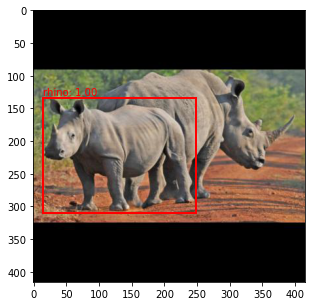

Visualizing prediction for image 94/152...


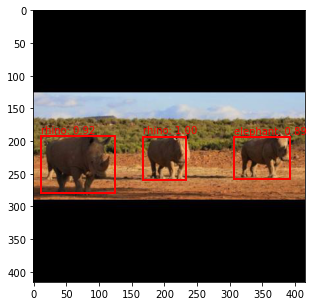

Visualizing prediction for image 95/152...


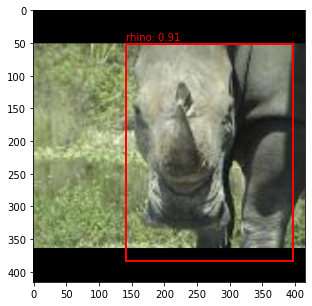

Visualizing prediction for image 96/152...


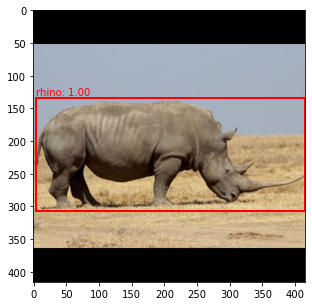

Visualizing prediction for image 97/152...


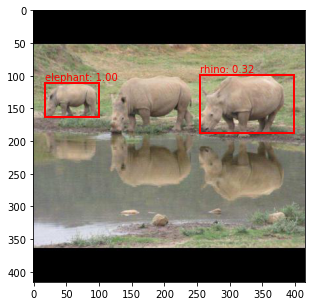

Visualizing prediction for image 98/152...


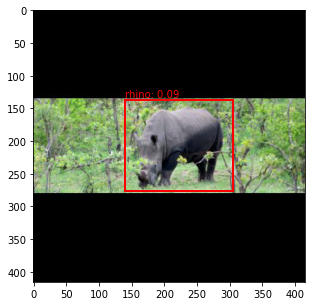

Visualizing prediction for image 99/152...


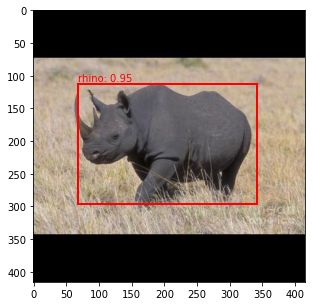

Visualizing prediction for image 100/152...


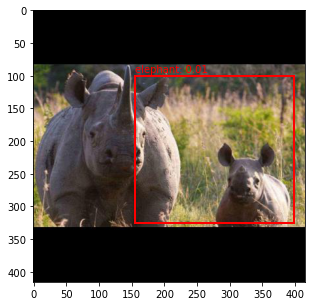

Visualizing prediction for image 101/152...


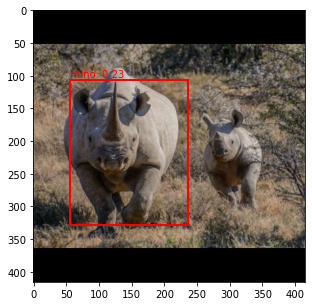

Visualizing prediction for image 102/152...


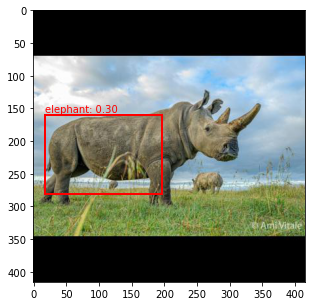

Visualizing prediction for image 103/152...


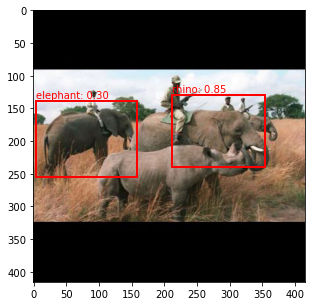

Visualizing prediction for image 104/152...


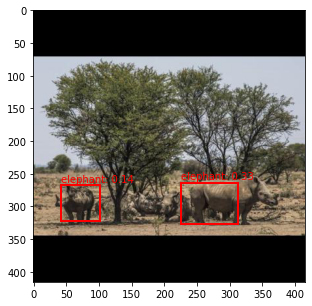

Visualizing prediction for image 105/152...


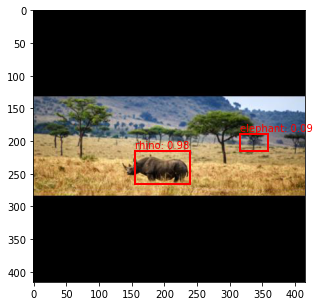

Visualizing prediction for image 106/152...


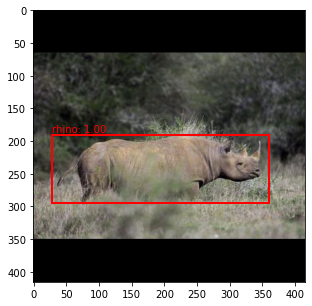

Visualizing prediction for image 107/152...


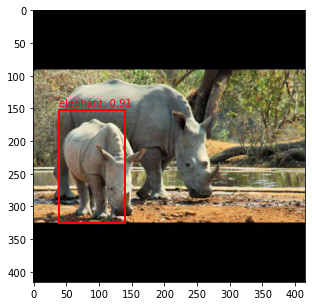

Visualizing prediction for image 108/152...


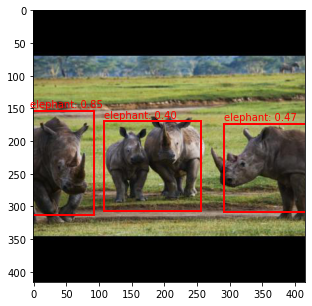

Visualizing prediction for image 109/152...


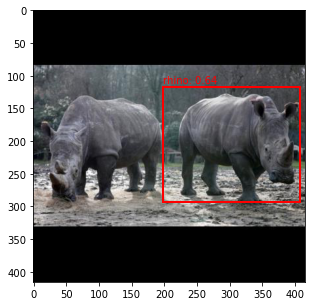

Visualizing prediction for image 110/152...


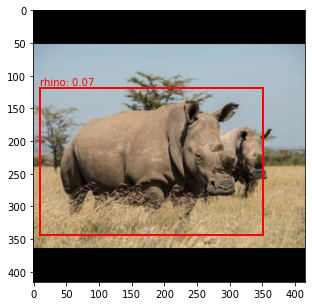

Visualizing prediction for image 111/152...


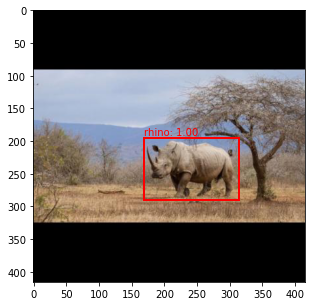

Visualizing prediction for image 112/152...


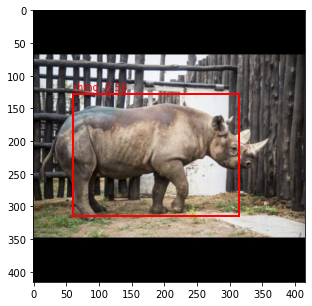

Visualizing prediction for image 113/152...


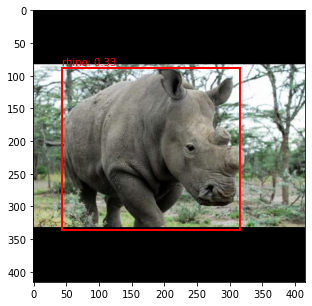

Visualizing prediction for image 114/152...


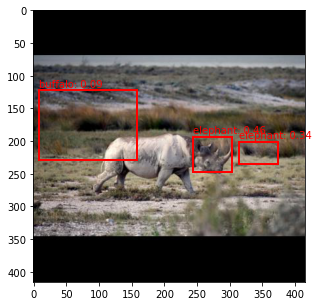

Visualizing prediction for image 115/152...


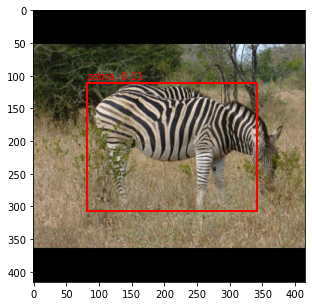

Visualizing prediction for image 116/152...


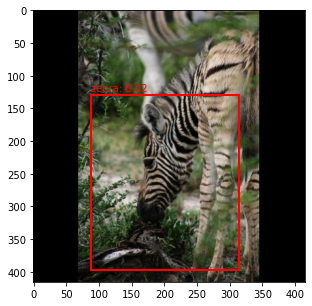

Visualizing prediction for image 117/152...


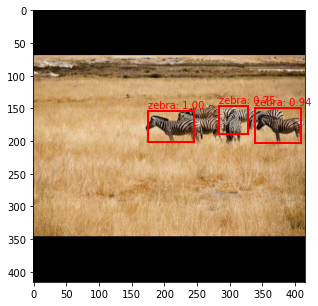

Visualizing prediction for image 118/152...


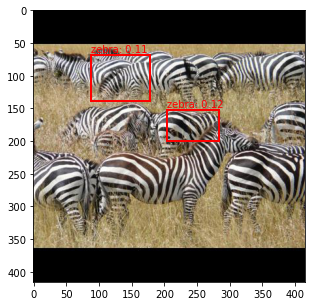

Visualizing prediction for image 119/152...


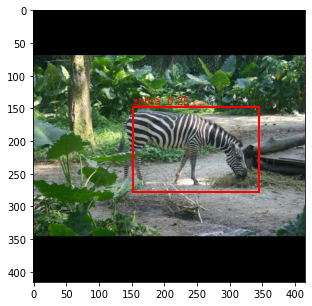

Visualizing prediction for image 120/152...


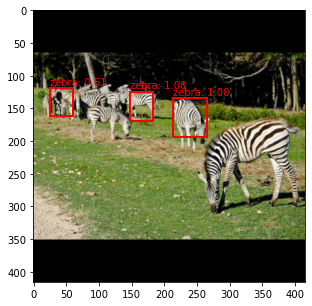

Visualizing prediction for image 121/152...


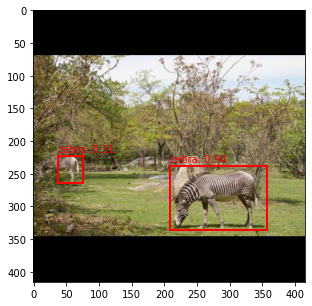

Visualizing prediction for image 122/152...


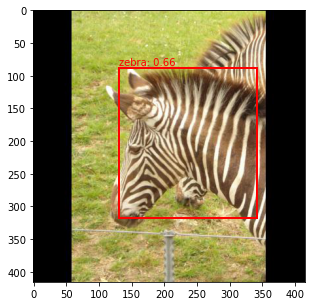

Visualizing prediction for image 123/152...


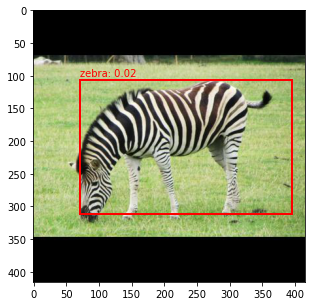

Visualizing prediction for image 124/152...


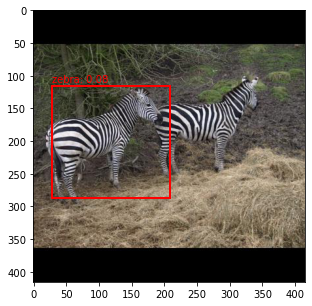

Visualizing prediction for image 125/152...


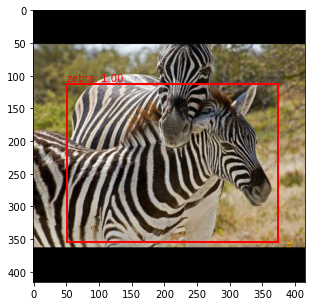

Visualizing prediction for image 126/152...


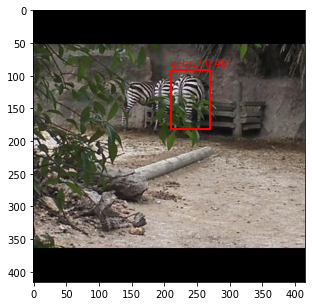

Visualizing prediction for image 127/152...


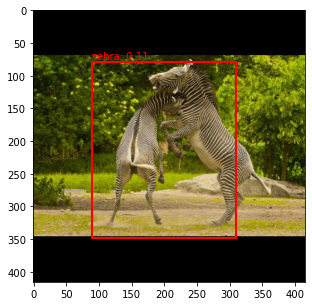

Visualizing prediction for image 128/152...


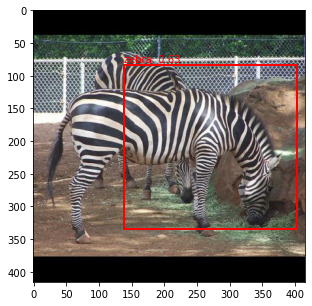

Visualizing prediction for image 129/152...


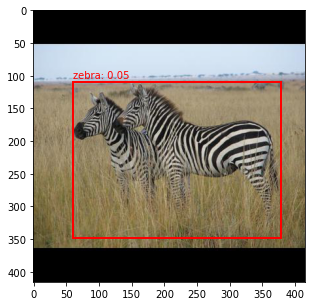

Visualizing prediction for image 130/152...


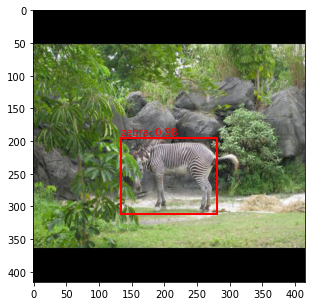

Visualizing prediction for image 131/152...


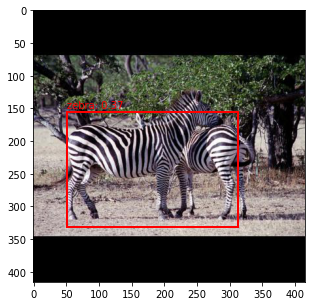

Visualizing prediction for image 132/152...


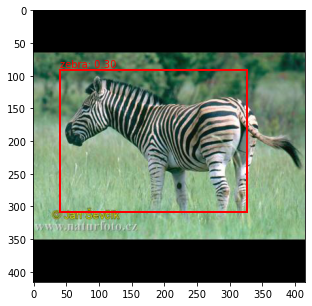

Visualizing prediction for image 133/152...


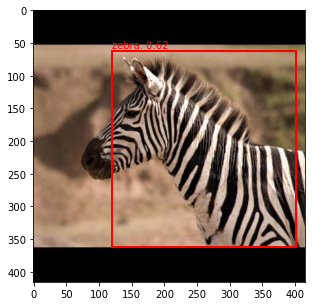

Visualizing prediction for image 134/152...


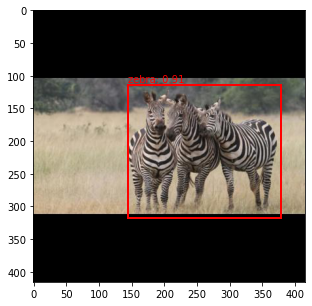

Visualizing prediction for image 135/152...


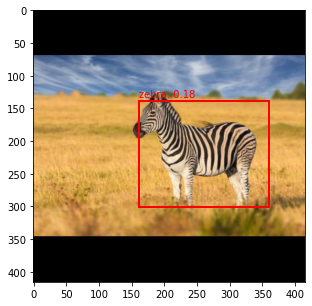

Visualizing prediction for image 136/152...


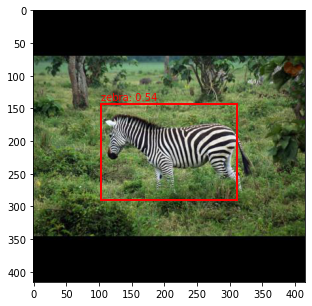

Visualizing prediction for image 137/152...


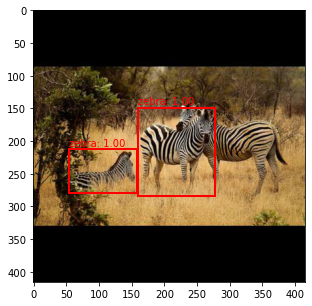

Visualizing prediction for image 138/152...


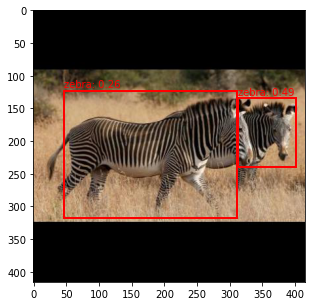

Visualizing prediction for image 139/152...


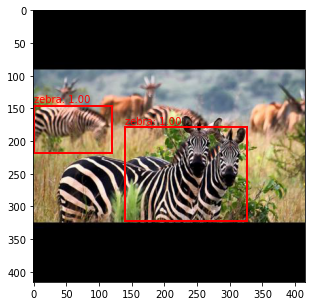

Visualizing prediction for image 140/152...


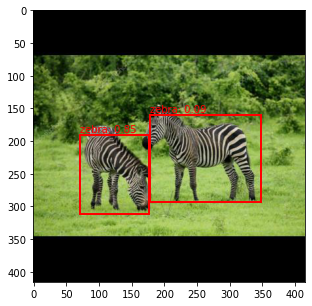

Visualizing prediction for image 141/152...


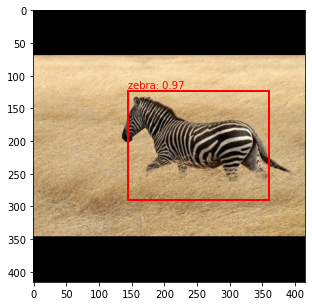

Visualizing prediction for image 142/152...


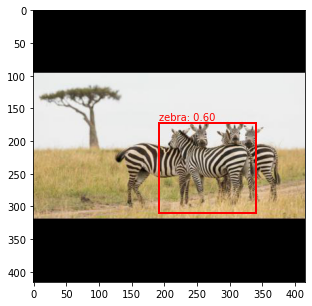

Visualizing prediction for image 143/152...


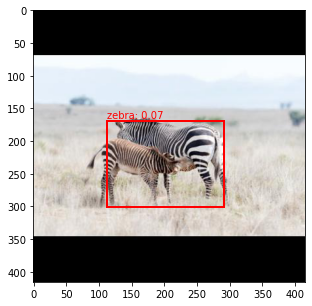

Visualizing prediction for image 144/152...


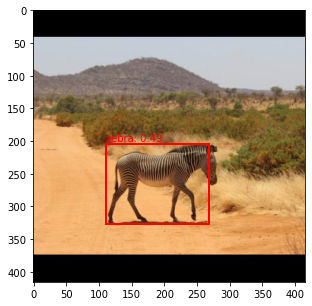

Visualizing prediction for image 145/152...


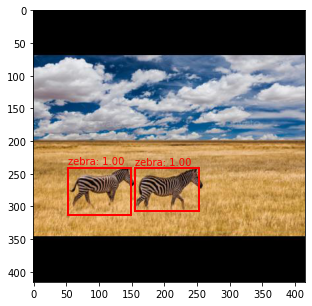

Visualizing prediction for image 146/152...


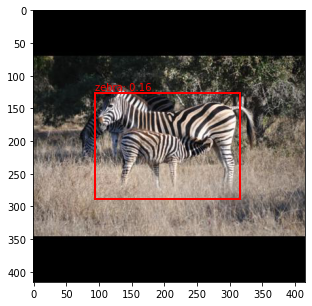

Visualizing prediction for image 147/152...


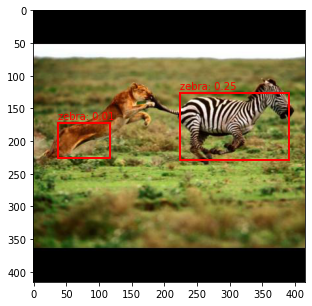

Visualizing prediction for image 148/152...


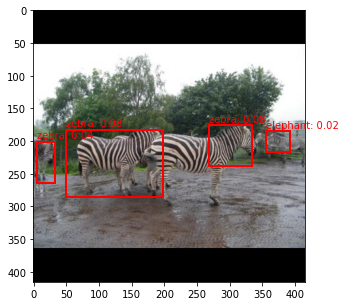

Visualizing prediction for image 149/152...


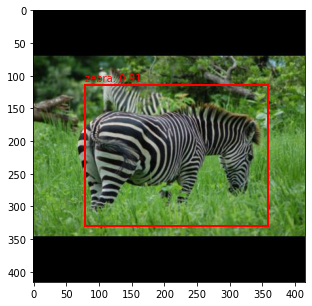

Visualizing prediction for image 150/152...


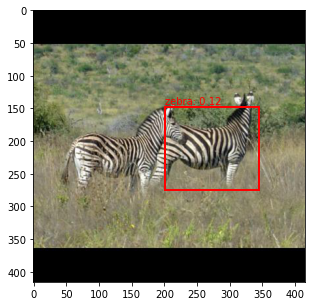

Visualizing prediction for image 151/152...


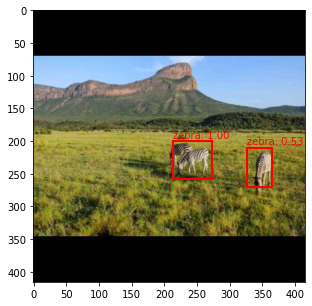

Visualizing prediction for image 152/152...


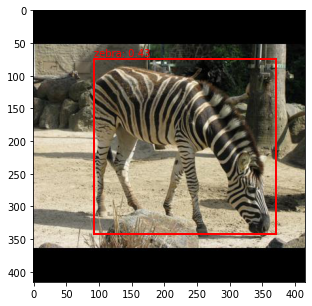

In [22]:
# Define class names
class_names = ['buffalo', 'elephant', 'rhino', 'zebra']

# To display an image with bounding boxes
def show_image_with_boxes(image, boxes, scores, labels, class_names):
    # Convert to numpy array for matplotlib
    image = np.array(image)
    
    # Get image dimensions
    img_width, img_height = image.shape[1], image.shape[0]
    
    fig, ax = plt.subplots(1, figsize=(5, 5))
    ax.imshow(image)
    
    for box, score, label in zip(boxes, scores, labels):
        # Convert normalized coordinates to actual pixel values
        x1, y1, x2, y2 = box
        x1 = x1 * img_width
        y1 = y1 * img_height
        x2 = x2 * img_width
        y2 = y2 * img_height
        
        width = x2 - x1
        height = y2 - y1
        
        rect = Rectangle((x1, y1), width, height, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        
        # Annotate with label and score
        ax.text(x1, y1-5, f'{class_names[label]}: {score:.2f}', color='red', fontsize=10)
    
    plt.show()

# To decode predictions into bounding boxes
def decode_predictions(predictions, anchors, grid_size=13, conf_threshold=0.5, iou_threshold=0.5):
    batch_size, _, grid_h, grid_w = predictions.size()
    num_anchors = len(anchors)
    
    predictions = predictions.view(batch_size, num_anchors, 5 + 4, grid_h, grid_w)  # 5 + num_classes (4 classes here)
    predictions = predictions.permute(0, 1, 3, 4, 2).contiguous()

    tx = torch.sigmoid(predictions[..., 0])  # X center
    ty = torch.sigmoid(predictions[..., 1])  # Y center
    tw = predictions[..., 2]  # Width
    th = predictions[..., 3]  # Height
    obj_score = torch.sigmoid(predictions[..., 4])  # Objectness score
    class_probs = torch.softmax(predictions[..., 5:], dim=-1)  # Class probabilities

    grid_x = torch.arange(grid_w).repeat(grid_h, 1).view([1, 1, grid_h, grid_w]).float().to(device)
    grid_y = torch.arange(grid_h).repeat(grid_w, 1).t().view([1, 1, grid_h, grid_w]).float().to(device)

    # Anchors
    anchor_w = torch.tensor(anchors)[:, 0].view(1, num_anchors, 1, 1).to(device)
    anchor_h = torch.tensor(anchors)[:, 1].view(1, num_anchors, 1, 1).to(device)

    # Convert predictions to bounding box coordinates
    bx = (tx + grid_x) / grid_w
    by = (ty + grid_y) / grid_h
    bw = anchor_w * torch.exp(tw)
    bh = anchor_h * torch.exp(th)

    # Apply confidence threshold
    mask = obj_score > conf_threshold

    boxes = torch.stack([
        bx[mask] - bw[mask]/2,
        by[mask] - bh[mask]/2,
        bx[mask] + bw[mask]/2,
        by[mask] + bh[mask]/2
    ], dim=-1)

    scores = obj_score[mask]
    class_ids = torch.argmax(class_probs[mask], dim=-1)

    # Apply NMS per class
    keep = nms(boxes, scores, iou_threshold)
    boxes = boxes[keep]
    scores = scores[keep]
    class_ids = class_ids[keep]

    return boxes, scores, class_ids

all_predictions = []
with torch.no_grad():  # Disable gradient computation
    for idx in range(len(test_dataset)):
        image, _ = test_dataset[idx]  # Retrieve image and label
        image = image.unsqueeze(0).to(device)  # Add batch dimension and move to device
        
        # Model predictions
        outputs = model(image)
        
        # Decode the predictions
        boxes, scores, class_ids = decode_predictions(outputs, anchors=ANCHORS, grid_size=13, conf_threshold=0.01, iou_threshold=0.0)
        
        # Save the results
        all_predictions.append({
            'boxes': boxes.cpu(),
            'scores': scores.cpu(),
            'labels': class_ids.cpu()
        })
        
# Visualize the predictions for all images in the test set
for idx, pred in enumerate(all_predictions):
    # Get the image from the test dataset using the same index
    image, _ = test_dataset[idx]
    test_image_path = os.path.join(test_dataset.image_dir, test_dataset.image_files[idx])  # Get image path
    test_image = Image.open(test_image_path)  # Open the image using PIL
    
    print(f"Visualizing prediction for image {idx + 1}/{len(all_predictions)}...")
    show_image_with_boxes(test_image, pred['boxes'], pred['scores'], pred['labels'], class_names)

#### Class distribution

In [46]:
import os
import pandas as pd

def analyze_labels(dataset_path):
    """Analyzes label files, handling multiple labels per file and space-separated values."""

    labels_dir = os.path.join(dataset_path, 'labels')
    if not os.path.exists(labels_dir):
        print(f"Error: Labels directory not found in {dataset_path}")
        return None

    class_counts = {}

    for filename in os.listdir(labels_dir):
        if filename.endswith('.txt'):
            filepath = os.path.join(labels_dir, filename)
            try:
                with open(filepath, 'r') as f:
                    for line in f:  # Iterate through all lines in the file
                        line = line.strip()
                        if line: #check if the line is empty
                            parts = line.split()
                            class_id = parts[0]
                            if class_id in class_counts:
                                class_counts[class_id] += 1
                            else:
                                class_counts[class_id] = 1
                        else:
                            print(f"Warning: Empty line in file: {filename}")

            except Exception as e:
                print(f"Error processing file {filename}: {e}")
                return None

    df = pd.DataFrame(list(class_counts.items()), columns=['class_id', 'count'])
    return df

# Example usage (same as before):
dataset_names = ['../data/resized_test', '../data/resized_train', '../data/resized_val']

for dataset_name in dataset_names:
    dataset_path = dataset_name # or provide the full path if needed, e.g., './data/' + dataset_name
    df = analyze_labels(dataset_path)

    if df is not None:
        print(f"Analysis for {dataset_name}:")
        print(df)
        print("-" * 20)


Analysis for ../data/resized_test:
  class_id  count
0        0     54
1        3     95
2        1     68
3        2     60
--------------------
Analysis for ../data/resized_train:
  class_id  count
0        0    443
1        3    660
2        1    605
3        2    446
--------------------
Analysis for ../data/resized_val:
  class_id  count
0        0     56
1        1     74
2        2     52
3        3     69
--------------------


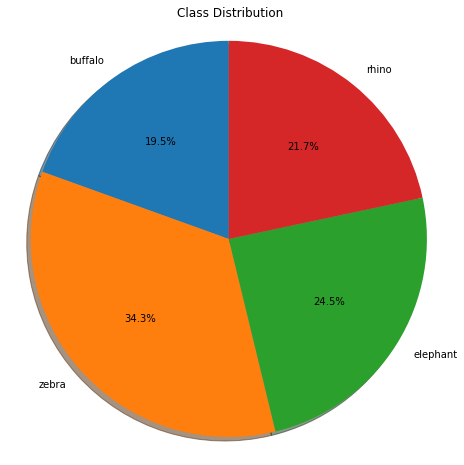

In [49]:
df = analyze_labels(dataset_names[0])
class_mapping = {i: name for i, name in enumerate(class_names)}
df['class_name'] = df['class_id'].astype(int).map(class_mapping)
labels = df['class_name']
sizes = df['count']
plt.figure(figsize=(8, 8)) 
plt.pie(sizes, labels=labels, autopct='%1.1f%%', shadow=True, startangle=90)
plt.title('Class Distribution')
plt.axis('equal')
plt.show()